In [2]:
os.chdir("..")

In [9]:
import os
import pandas as pd
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import os
import torch
from src.models.backbones import tracknet
from src.models.utils import save_checkpoint, load_checkpoint

In [10]:
all_tracks = pd.read_csv("data/MOT17_tracknet_training/MOT17_tracknet_training.txt")
MOT_path = os.path.join("data","MOT17","train")

In [11]:
all_tracks

,frame_id,track_id,x,y,w,h,conf,seq_id,10,11,tracklet_length,s_track_id
0,1.0,0.0,632.0,760.0,99.0,253.0,0.957580,MOT17-04-FRCNN,1920,1080,1050,0
1,1.0,1.0,288.0,122.0,53.0,172.0,0.951241,MOT17-04-FRCNN,1920,1080,1050,1
2,1.0,2.0,1729.0,457.0,78.0,216.0,0.948803,MOT17-04-FRCNN,1920,1080,1050,2
3,1.0,3.0,370.0,410.0,83.0,240.0,0.943440,MOT17-04-FRCNN,1920,1080,519,3
4,1.0,4.0,512.0,143.0,91.0,185.0,0.942543,MOT17-04-FRCNN,1920,1080,656,4
...,...,...,...,...,...,...,...,...,...,...,...,...
87882,654.0,736.0,1234.0,330.0,56.0,138.0,0.837125,MOT17-10-FRCNN,1920,1080,205,362
87883,654.0,737.0,768.0,342.0,23.0,45.0,0.722532,MOT17-10-FRCNN,1920,1080,176,363
87884,654.0,743.0,725.0,342.0,25.0,56.0,0.714652,MOT17-10-FRCNN,1920,1080,107,366
87885,654.0,746.0,705.0,341.0,27.0,57.0,0.732593,MOT17-10-FRCNN,1920,1080,87,369


In [12]:
total_tracks = all_tracks.s_track_id.max()

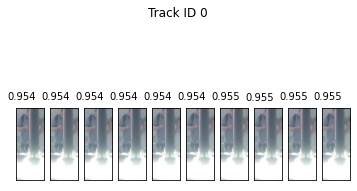

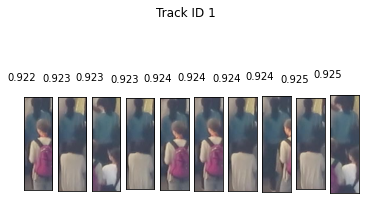

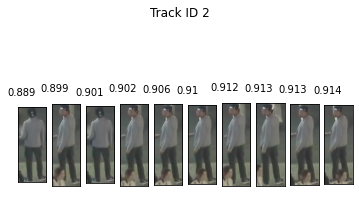

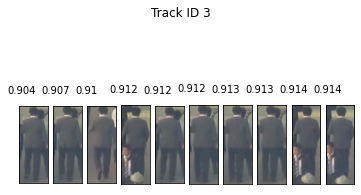

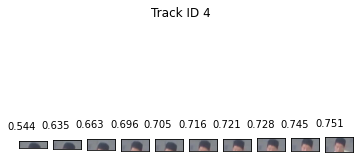

...

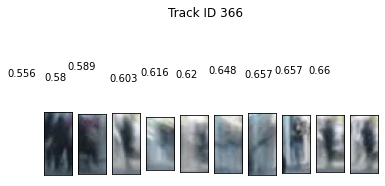

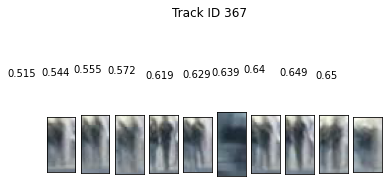

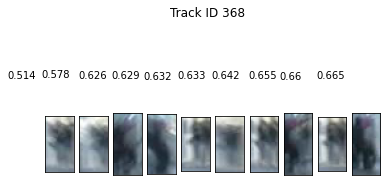

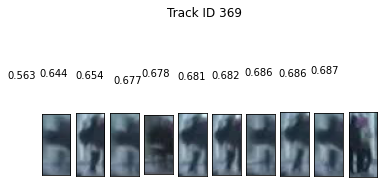

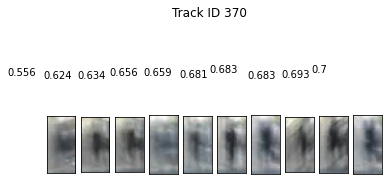

In [13]:
for t in range(total_tracks):
    t_track = all_tracks[all_tracks['s_track_id']==t].sort_values('conf')[:10]
    d_track = t_track.to_dict(orient="records")
    fig, ax = plt.subplots(1, 10)
    fig.suptitle('Track ID {t}'.format(t=t))
    for k,d in enumerate(d_track):
        fig.axes[k].get_xaxis().set_visible(False)
        fig.axes[k].get_yaxis().set_visible(False)
        img_dir = os.path.join(MOT_path,d["seq_id"])
        frame_dir = os.path.join(img_dir,"img1")
        frames = sorted(os.listdir(frame_dir))
        bbox = np.array([d["x"],d["y"],d["w"],d["h"]]).astype(int)
        img = mpimg.imread(os.path.join(frame_dir,frames[int(d["frame_id"]-1)]))
        patch = img[bbox[1]:bbox[1]+bbox[3],bbox[0]:bbox[0]+bbox[2]]
        ax[k].text(-30,-30,round(d['conf'],3))
        ax[k].imshow(patch)
    plt.show()

In [7]:
ckpt_path = os.path.join("models","tracknet","triplet_loss","checkpoints","9","latest_model.ckpt")

In [8]:
ckpt_path

'models/tracknet/triplet_loss/checkpoints/9/latest_model.ckpt'

In [10]:
torch.load(ckpt_path)

UnpicklingError: A load persistent id instruction was encountered,
but no persistent_load function was specified.

In [3]:
print(torch.__version__)

0.4.1
